<a href="https://colab.research.google.com/github/snvssk/data298A/blob/development/SatelliteImagery/MLModels/MaskRCNN_Detectron2_yaml.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Install Detectron2 Pip Packages, Import Deps

In [ ]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

In [2]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Sun_Feb_14_21:12:58_PST_2021
Cuda compilation tools, release 11.2, V11.2.152
Build cuda_11.2.r11.2/compiler.29618528_0
torch:  1.12 ; cuda:  cu113
detectron2: 0.6


In [4]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [5]:
import logging
from collections import OrderedDict

from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random

# import some common detectron2 utilities

from detectron2.data.datasets import register_coco_instances


from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.engine import DefaultTrainer
from detectron2.utils.visualizer import ColorMode
from detectron2.solver import build_lr_scheduler, build_optimizer
from detectron2.checkpoint import DetectionCheckpointer, PeriodicCheckpointer
from detectron2.utils.events import EventStorage
from detectron2.modeling import build_model
import detectron2.utils.comm as comm
from detectron2.engine import default_argument_parser, default_setup, default_writers, launch
from detectron2.data import (
    MetadataCatalog,
    build_detection_test_loader,
    build_detection_train_loader,
)
from detectron2.evaluation import (
    COCOEvaluator,
    inference_on_dataset,
    print_csv_format,
)

from matplotlib import pyplot as plt
from PIL import Image
from google.colab.patches import cv2_imshow
from detectron2.utils.visualizer import Visualizer

In [9]:
#!cp '/content/drive/Shareddrives/DATA298/DL_Model_Sample_Datasets/Building Image.zip' /content/
#!unzip '/content/Building Image.zip'
!rm -rf /content/__MACOSX

Archive:  /content/Building Image.zip
replace __MACOSX/._Building Image? [y]es, [n]o, [A]ll, [N]one, [r]ename: N


# Download dataset via Roboflow pip package and show a sample annotation

We need to register the datasets we have to use.

In [10]:
register_coco_instances("my_dataset_train", {}, f"/content/Building Image/train/_annotations.coco.json", f"/content/Building Image/train/")
register_coco_instances("my_dataset_val", {}, f"/content/Building Image/valid/_annotations.coco.json", f"/content/Building Image/valid/")
register_coco_instances("my_dataset_test", {}, f"/content/Building Image/test/_annotations.coco.json", f"/content/Building Image/test/")


Visualizing some images from the dataset.

WARNING [11/17 05:29:12 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[11/17 05:29:12 d2.data.datasets.coco]: Loaded 338 images in COCO format from /content/Building Image/train/_annotations.coco.json


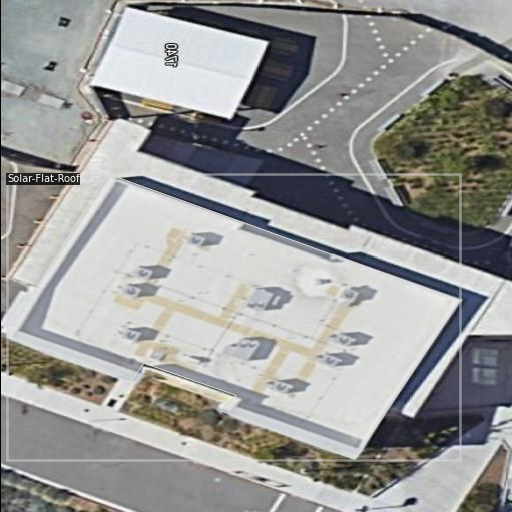

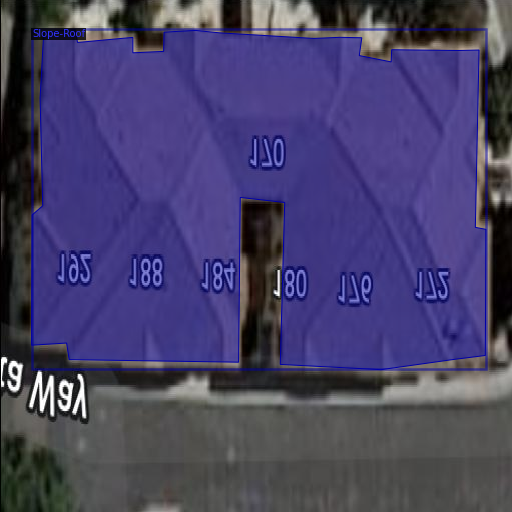

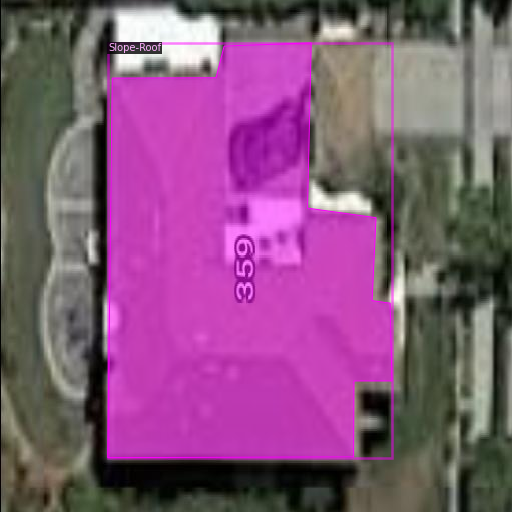

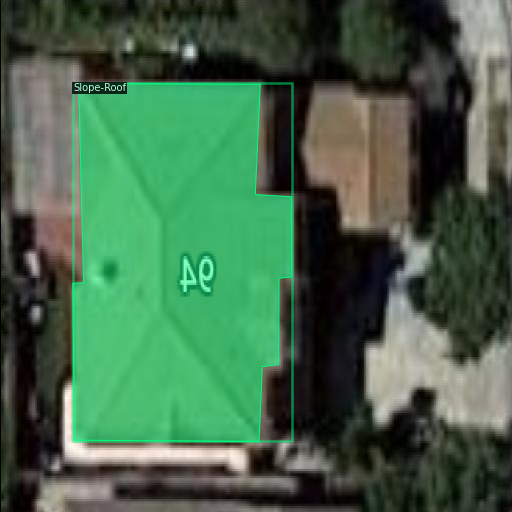

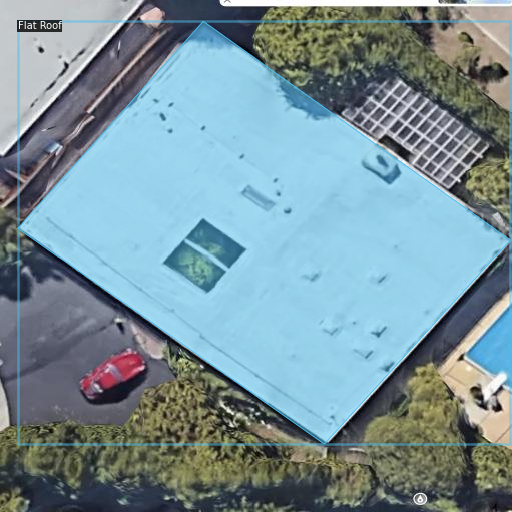

In [11]:
#visualize training data
train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

for d in random.sample(dataset_dicts, 5):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata = train_metadata)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Configure Detectron2 for fine tuning from COCO, Define training loop helper functions (from detectron2 repo), Run custom training loop

In [23]:
cfg = get_cfg()             #mask_rcnn_R_50_FPN_3x.yaml
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)#Train dataset registered in a previous cell
cfg.DATASETS.TEST = ("my_dataset_test",)#Test dataset registered in a previous cell
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025

cfg.SOLVER.MAX_ITER = 4000 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = []
cfg.SOLVER.GAMMA = 0.05

cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 14 #13 roof types plus one super class (We have removed a non roof class)
cfg.TEST.EVAL_PERIOD = 0 # Increase this number if you want to monitor validation performance during training

PATIENCE = 1000 #Early stopping will occur after N iterations of no imporovement in total_loss

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

In [24]:
def do_test(cfg, model):
    results = OrderedDict()
    for dataset_name in cfg.DATASETS.TEST:
        data_loader = build_detection_test_loader(cfg, dataset_name)
        evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/inference")
        results_i = inference_on_dataset(model, data_loader, evaluator)
        results[dataset_name] = results_i
        if comm.is_main_process():
            logger.info("Evaluation results for {} in csv format:".format(dataset_name))
            print_csv_format(results_i)
    if len(results) == 1:
        results = list(results.values())[0]
    return results



In [25]:
logger = logging.getLogger("detectron2")
resume = False
model = build_model(cfg)
optimizer = build_optimizer(cfg, model)
scheduler = build_lr_scheduler(cfg, optimizer)
BEST_LOSS = np.inf

checkpointer = DetectionCheckpointer(model, cfg.OUTPUT_DIR, optimizer=optimizer, scheduler=scheduler)
start_iter = (checkpointer.resume_or_load(cfg.MODEL.WEIGHTS, resume=resume).get("iteration", -1) + 1)
prev_iter = start_iter
max_iter = cfg.SOLVER.MAX_ITER
periodic_checkpointer = PeriodicCheckpointer(checkpointer, cfg.SOLVER.CHECKPOINT_PERIOD, max_iter=max_iter)
writers = default_writers(cfg.OUTPUT_DIR, max_iter) if comm.is_main_process() else []

# compared to "train_net.py", we do not support accurate timing and
# precise BN here, because they are not trivial to implement in a small training loop
data_loader = build_detection_train_loader(cfg)
logger.info("Starting training from iteration {}".format(start_iter))
patience_counter = 0
with EventStorage(start_iter) as storage:
    for data, iteration in zip(data_loader, range(start_iter, max_iter)):
        storage.iter = iteration

        loss_dict = model(data)
        losses = sum(loss_dict.values())
        assert torch.isfinite(losses).all(), loss_dict

        loss_dict_reduced = {k: v.item() for k, v in comm.reduce_dict(loss_dict).items()}
        losses_reduced = sum(loss for loss in loss_dict_reduced.values())
        if comm.is_main_process():
            storage.put_scalars(total_loss=losses_reduced, **loss_dict_reduced)

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()
        storage.put_scalar("lr", optimizer.param_groups[0]["lr"], smoothing_hint=False)
        scheduler.step()

        if (
            cfg.TEST.EVAL_PERIOD > 0
            and (iteration + 1) % cfg.TEST.EVAL_PERIOD == 0
            and iteration != max_iter - 1
        ):
            do_test(cfg, model)
            # Compared to "train_net.py", the test results are not dumped to EventStorage
            comm.synchronize()

        if iteration - start_iter > 5 and (
            (iteration + 1) % 20 == 0 or iteration == max_iter - 1
        ):
            for writer in writers:
                writer.write()
        periodic_checkpointer.step(iteration)
        
        if iteration > prev_iter:
            prev_iter = iteration
            if losses_reduced < BEST_LOSS:
                BEST_LOSS = losses_reduced
                patience_counter = 0
            else:
                patience_counter += 1
                if patience_counter % 100 == 0:
                    print(f"Loss has not improved for {patience_counter} iterations")
                if patience_counter >= PATIENCE:
                    print(f"EARLY STOPPING")
                    break
                


roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


WARNING [11/17 10:14:49 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[11/17 10:14:49 d2.data.datasets.coco]: Loaded 338 images in COCO format from /content/Building Image/train/_annotations.coco.json
[11/17 10:14:49 d2.data.build]: Removed 0 images with no usable annotations. 338 images left.
[11/17 10:14:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[11/17 10:14:49 d2.data.build]: Using training sampler TrainingSampler
[11/17 10:14:49 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common.NumpySerializedList'>
[11/17 10:14:49 d2.data.common]: Serializing 338 elements to byte tensors and concatenating them all ...
[11/17 10:14:49 d2.data.common]: Serialized dataset takes 0.19 MiB
[11/17 10:14:49 detectron2]: Starting training from iteration 0
[

In [26]:
do_test(cfg, model)

WARNING [11/17 11:55:18 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[11/17 11:55:18 d2.data.datasets.coco]: Loaded 90 images in COCO format from /content/Building Image/test/_annotations.coco.json
[11/17 11:55:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[11/17 11:55:18 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common.NumpySerializedList'>
[11/17 11:55:18 d2.data.common]: Serializing 90 elements to byte tensors and concatenating them all ...
[11/17 11:55:18 d2.data.common]: Serialized dataset takes 0.06 MiB
WARNING [11/17 11:55:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[11/17 11:55:18 d2.evaluation.evaluator]: Start inference on 90 batches
[11/17 11:55:21 d2.evalu

OrderedDict([('bbox',
              {'AP': 26.280453135119142,
               'AP50': 36.26269097213721,
               'AP75': 30.09064480701273,
               'APs': nan,
               'APm': nan,
               'APl': 26.280453135119142,
               'AP-Building-Roof': nan,
               'AP-Commercial-Flat-Roof': 60.29702970297029,
               'AP-Commercial-Slope-Roof': nan,
               'AP-Construction-Area': 0.0,
               'AP-Flat Roof': 57.52475247524752,
               'AP-Playground': nan,
               'AP-Slope-Flat-Roof': 0.0,
               'AP-Slope-Roof': 53.52097592492938,
               'AP-Solar-Flat-Roof': 14.207920792079204,
               'AP-Solar-Pannel-Ground': nan,
               'AP-Solar-Slope-Roof': 46.55508248916275,
               'AP-TreeShading-Slope-Roof': 0.0,
               'AP-Unknownshape-Roof': 4.4183168316831685}),
             ('segm',
              {'AP': 27.67921919323797,
               'AP50': 36.26269097213721,
          

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output


# Test model and show example output

In [30]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "/content/output/model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model,higher the threshold better the model predicted 
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

[11/17 16:04:41 d2.checkpoint.c2_model_loading]: Following weights matched with model:
| Names in Model                                  | Names in Checkpoint                                                                                  | Shapes                                          |
|:------------------------------------------------|:-----------------------------------------------------------------------------------------------------|:------------------------------------------------|
| backbone.bottom_up.res2.0.conv1.*               | backbone.bottom_up.res2.0.conv1.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (256,) (256,) (256,) (256,) (256,64,1,1)        |
| backbone.bottom_up.res2.0.conv2.*               | backbone.bottom_up.res2.0.conv2.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (256,) (256,) (256,) (256,) (256,8,3,3)         |
| backbone.bottom_up.res2.0.conv3.*               | backbone.bottom_up.res2.0.conv3.{norm.bia

No Segmentation/Classification


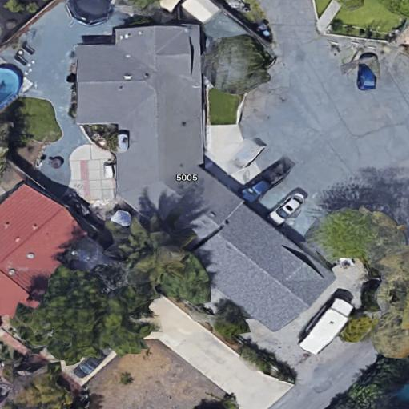

No Segmentation/Classification


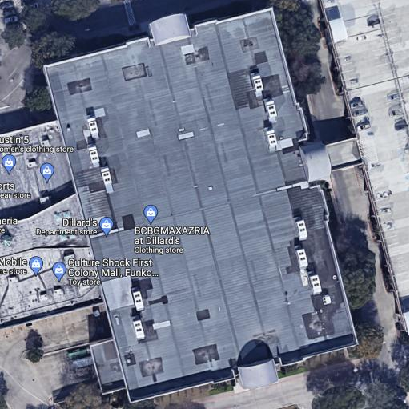

Segmented Area : 142.98600630830978 m


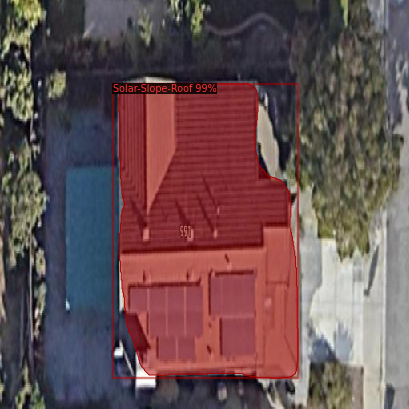

Segmented Area : 169.26037338963897 m


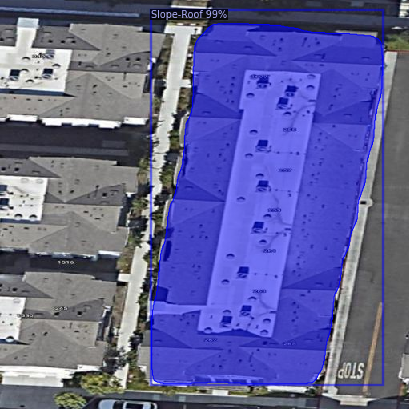

Segmented Area : 138.64981788664565 m


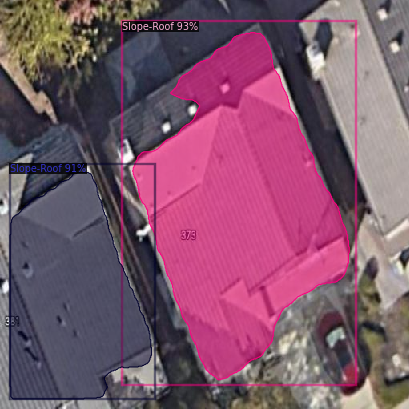

Segmented Area : 148.30330407647702 m


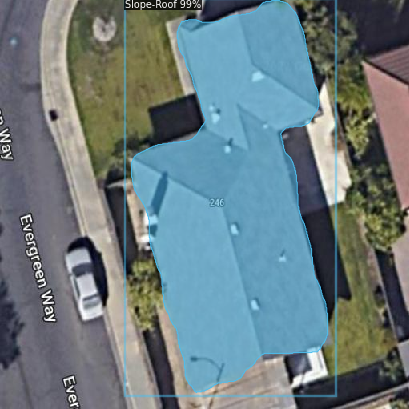

No Segmentation/Classification


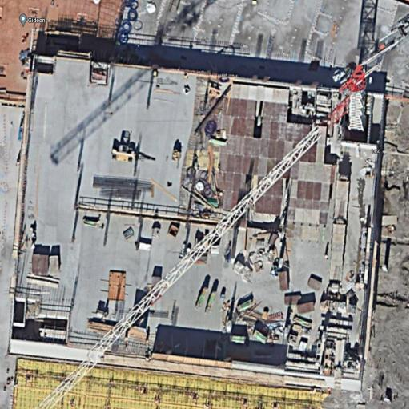

Segmented Area : 123.4744346008517 m


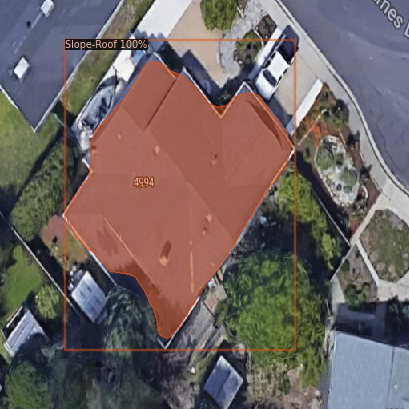

Segmented Area : 97.62950373734367 m


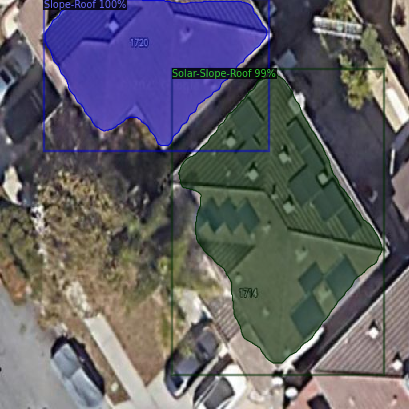

Segmented Area : 172.31246037358994 m


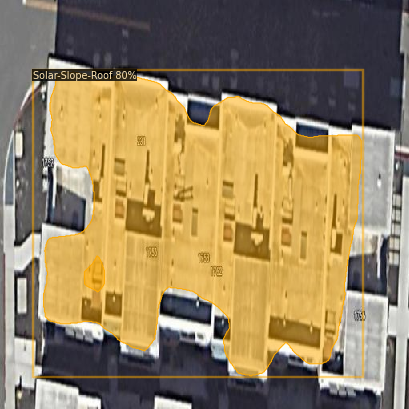

Segmented Area : 166.77933625002828 m


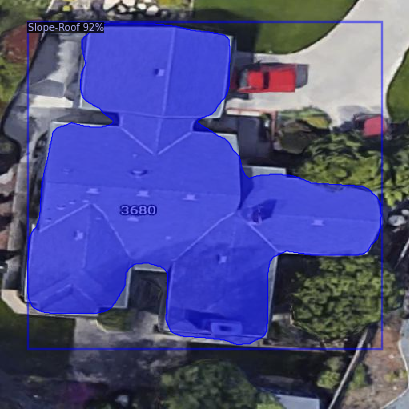

No Segmentation/Classification


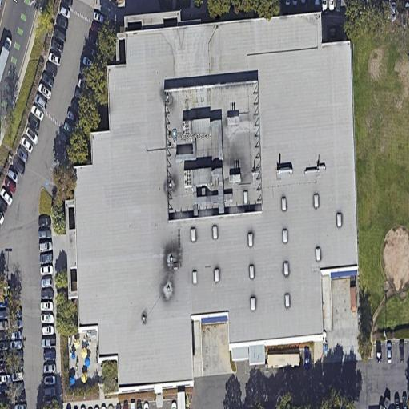

Segmented Area : 137.37013867649694 m


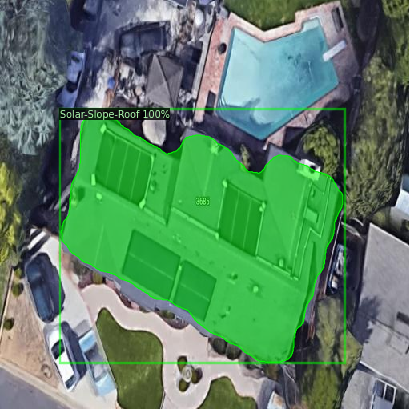

Segmented Area : 178.07856131494324 m


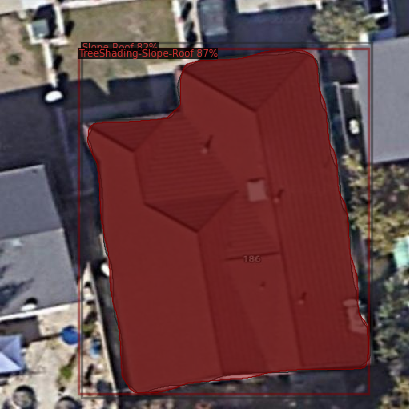

No Segmentation/Classification


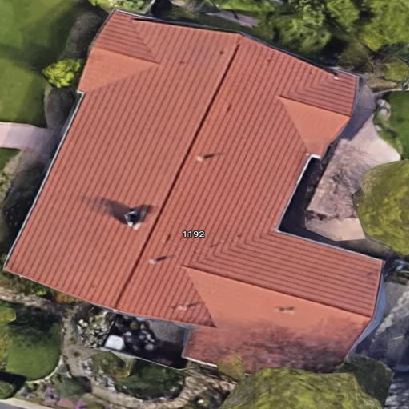

Segmented Area : 146.61493102682277 m


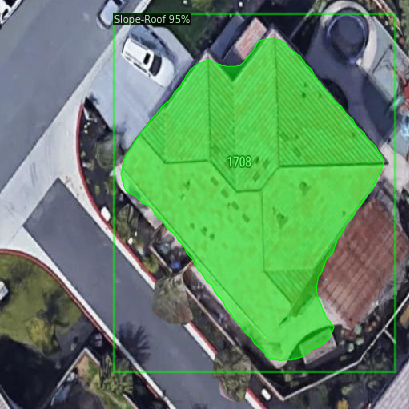

Segmented Area : 129.8016910521585 m


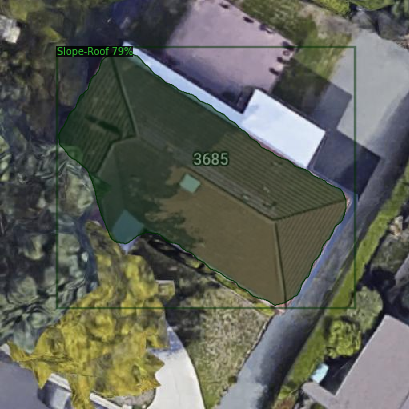

Segmented Area : 219.80385574416115 m


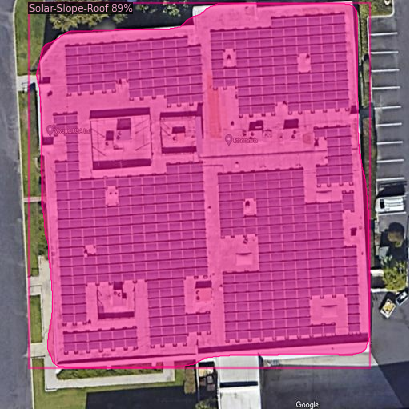

No Segmentation/Classification


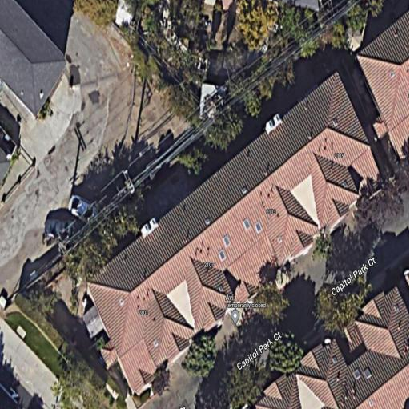

Segmented Area : 124.12246774859095 m


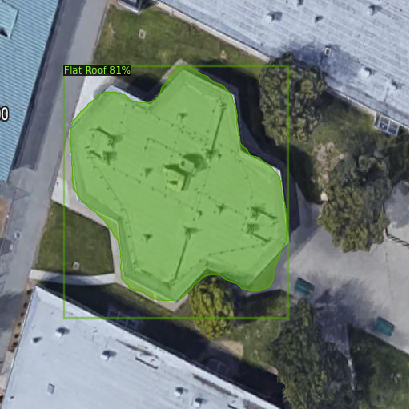

Segmented Area : 94.27634910198846 m


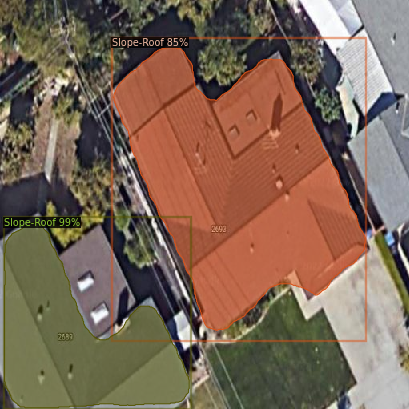

Segmented Area : 155.57794509505518 m


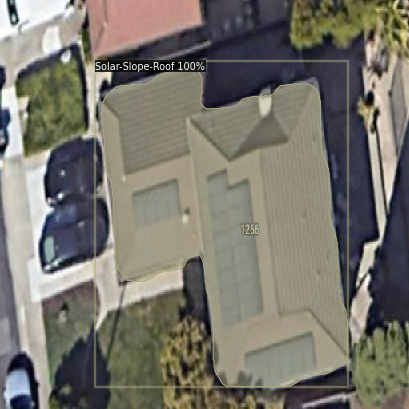

Segmented Area : 148.05583068558968 m


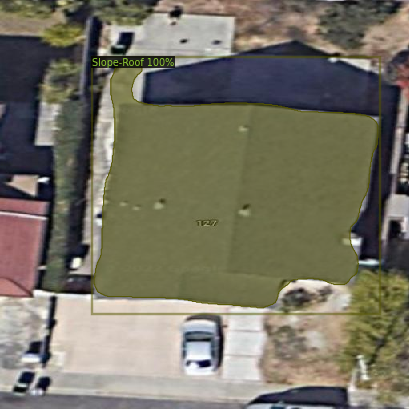

Segmented Area : 187.0023743164776 m


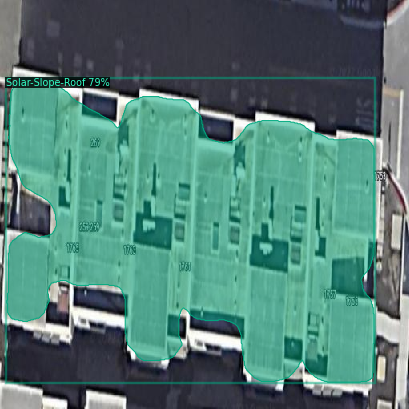

Segmented Area : 142.27084030116643 m


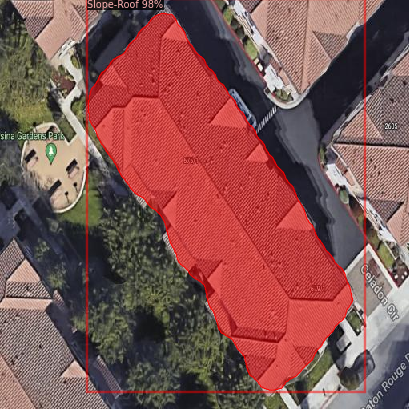

Segmented Area : 143.39125147651094 m


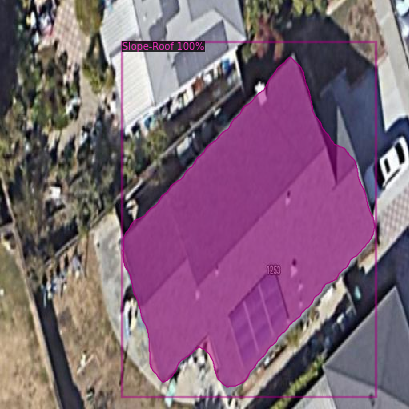

Segmented Area : 147.7042958075357 m


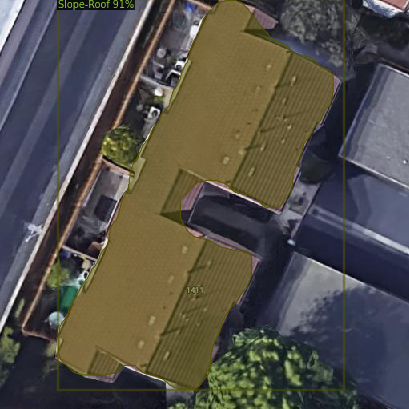

Segmented Area : 143.3451917575194 m


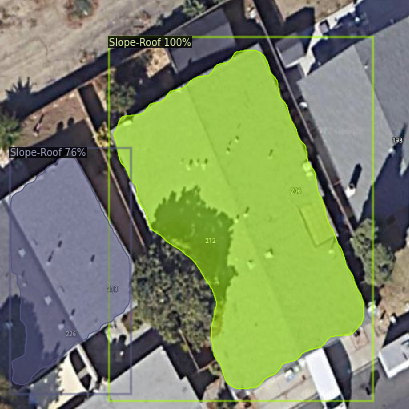

Segmented Area : 162.72428214621198 m


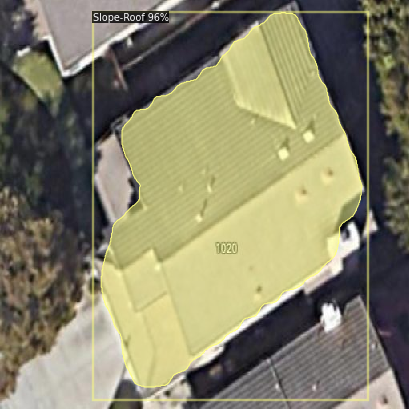

Segmented Area : 140.07836735199336 m


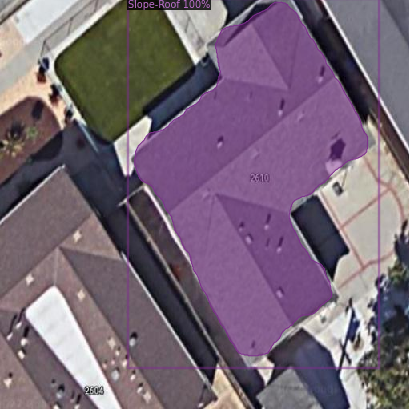

Segmented Area : 174.30433442688684 m


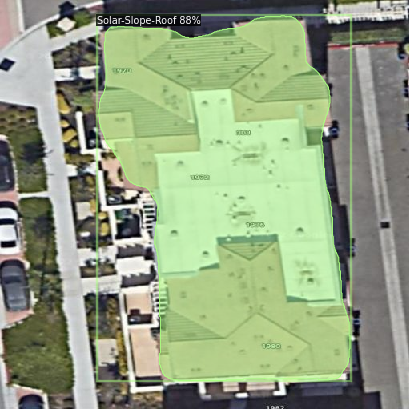

Segmented Area : 123.01957974241337 m


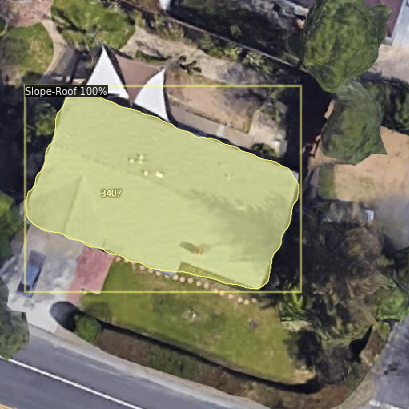

No Segmentation/Classification


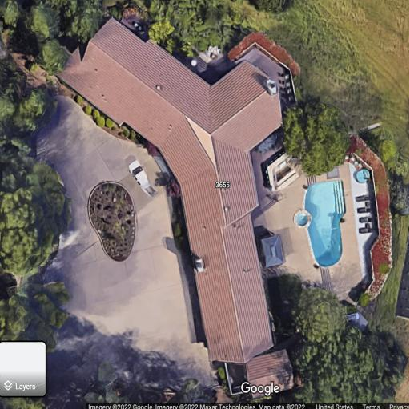

Segmented Area : 181.06194243959717 m


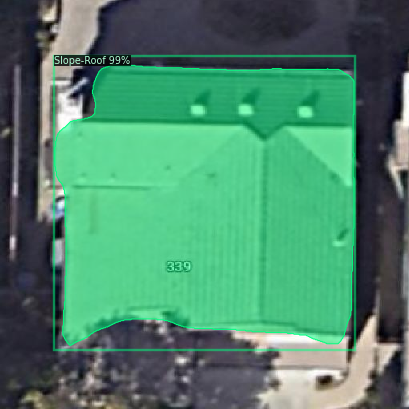

No Segmentation/Classification


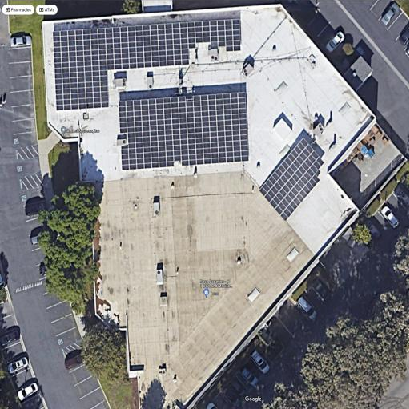

No Segmentation/Classification


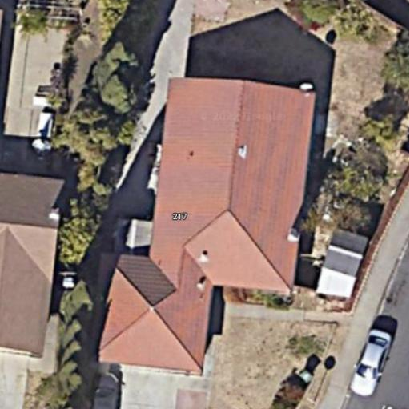

Segmented Area : 151.4808898838398 m


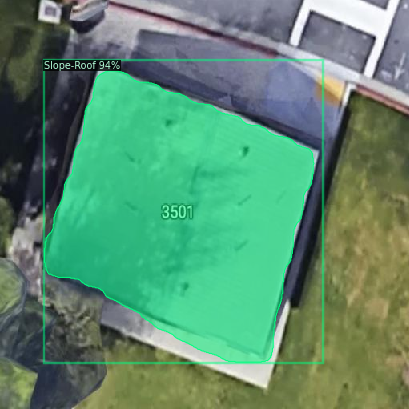

Segmented Area : 128.77910544805007 m


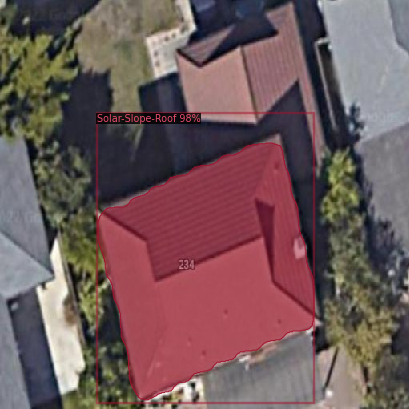

Segmented Area : 91.33634544911462 m


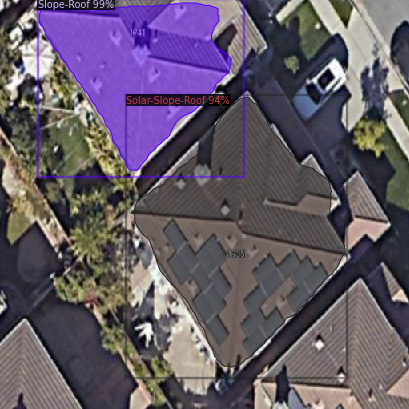

No Segmentation/Classification


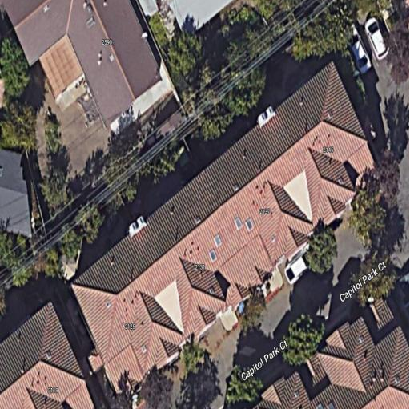

Segmented Area : 138.66400398084573 m


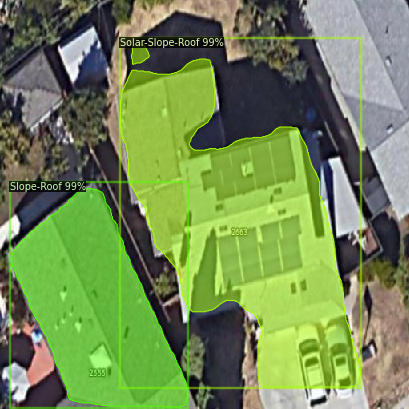

Segmented Area : 134.33577706627526 m


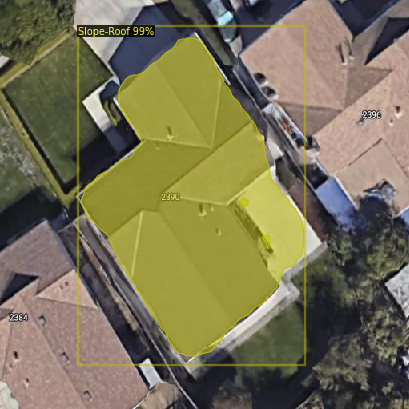

Segmented Area : 166.65882514886513 m


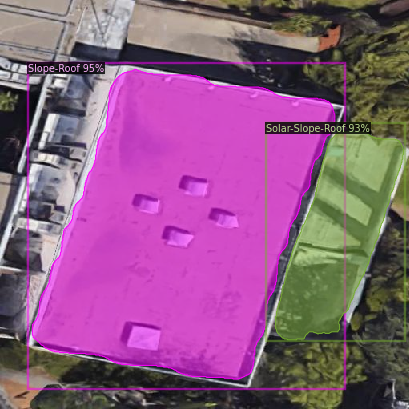

Segmented Area : 154.62407315809529 m


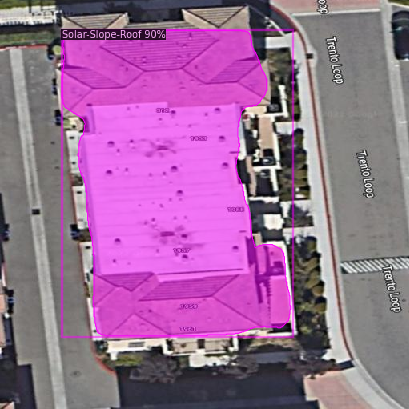

Segmented Area : 137.92846696748282 m


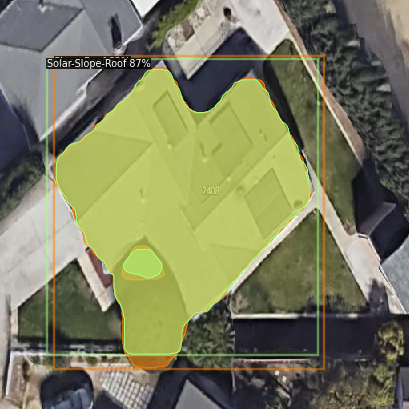

Segmented Area : 145.47299062025226 m


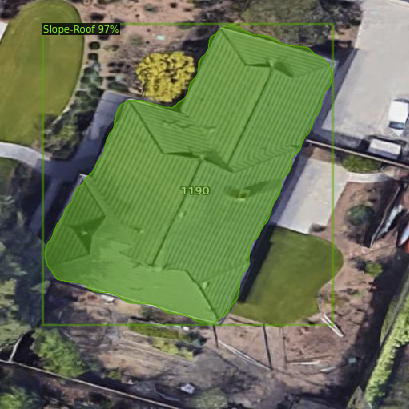

Segmented Area : 125.57978340481401 m


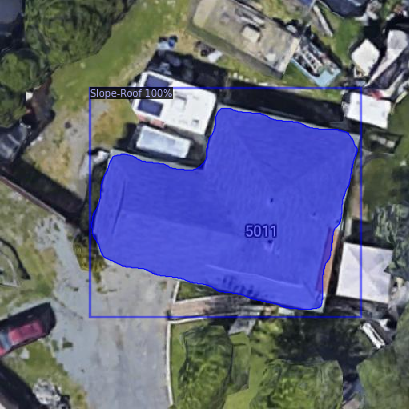

Segmented Area : 189.49074383726506 m


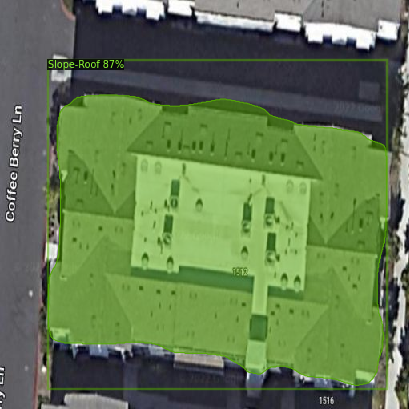

Segmented Area : 191.9212364487057 m


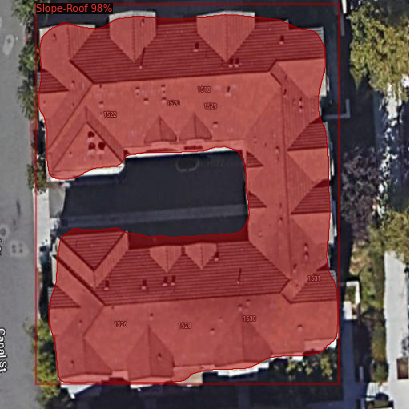

Segmented Area : 148.17535220136986 m


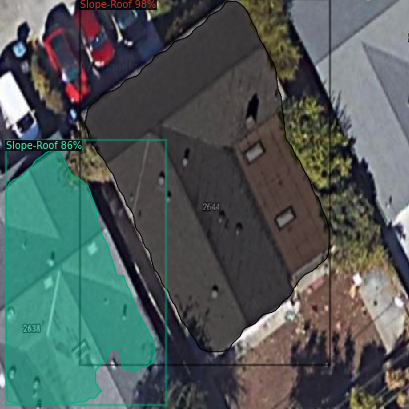

Segmented Area : 99.35840175848242 m


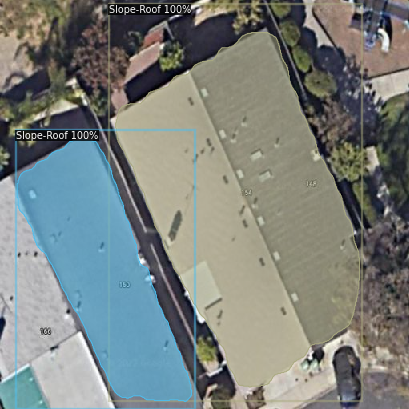

No Segmentation/Classification


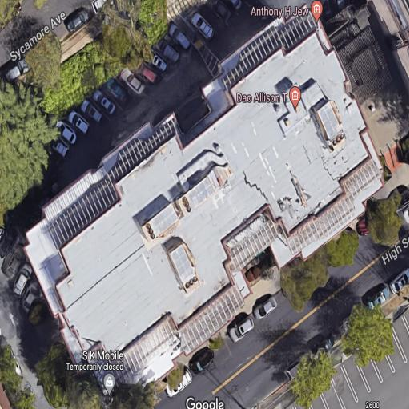

No Segmentation/Classification


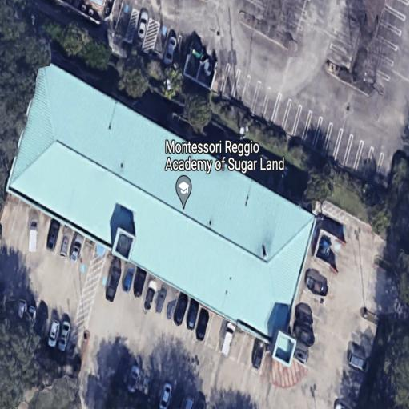

Segmented Area : 127.23589116283189 m


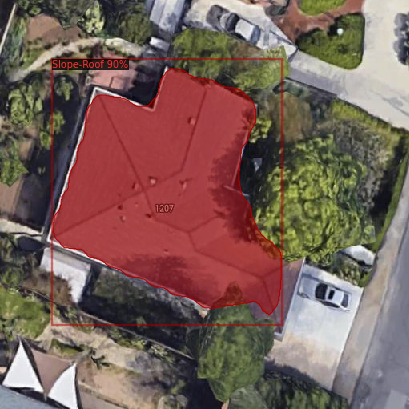

Segmented Area : 135.63269148697154 m


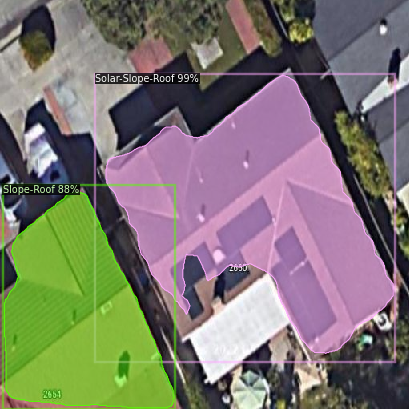

Segmented Area : 152.16108240939928 m


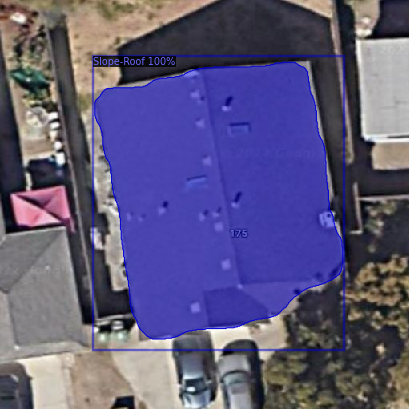

Segmented Area : 121.7856395475263 m


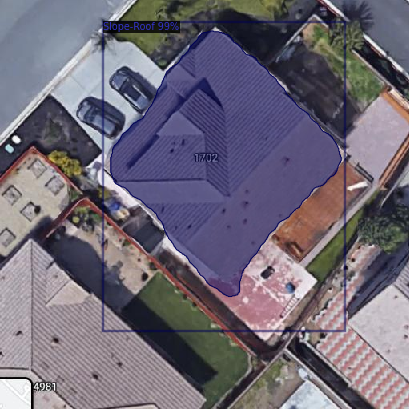

Segmented Area : 157.59767764786383 m


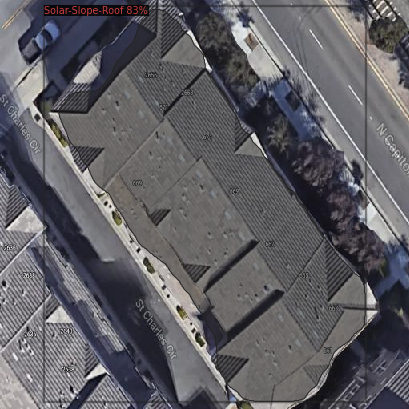

Segmented Area : 139.85451726705148 m


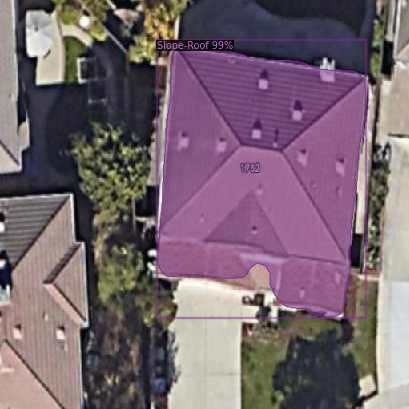

Segmented Area : 138.969665754797 m


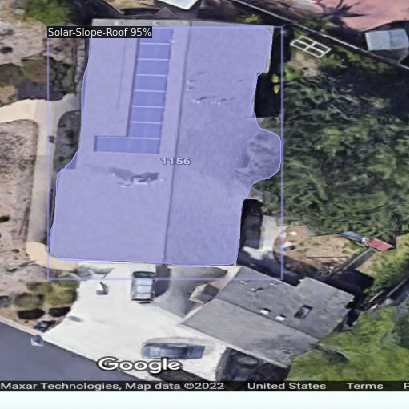

Segmented Area : 159.24460744401992 m


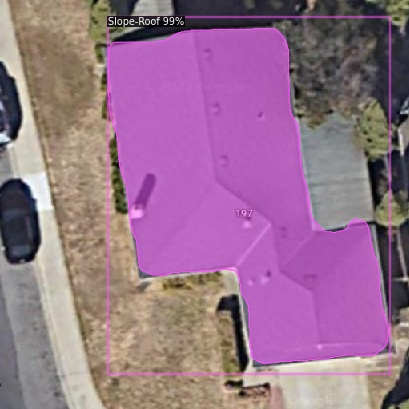

Segmented Area : 114.06516558529164 m


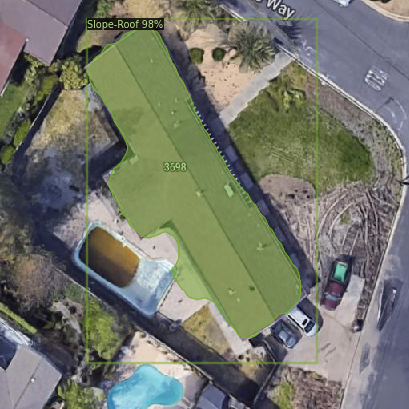

Segmented Area : 197.63918639783967 m


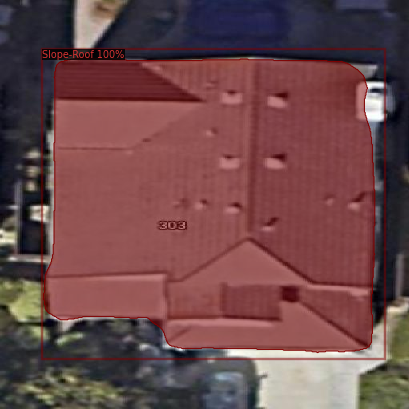

Segmented Area : 178.97495076127274 m


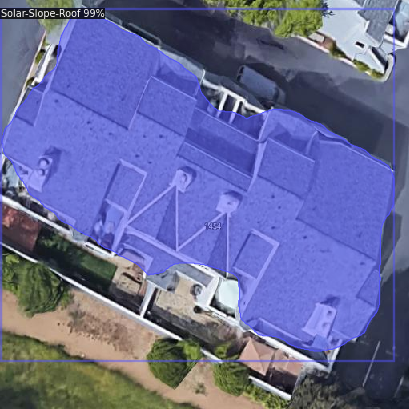

Segmented Area : 180.947837787579 m


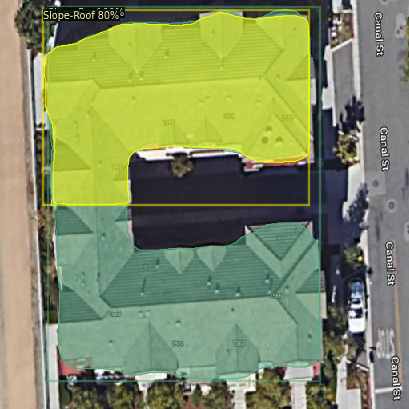

Segmented Area : 179.18835062581496 m


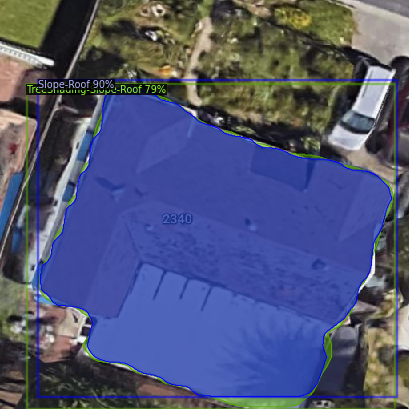

Segmented Area : 153.6770802689848 m


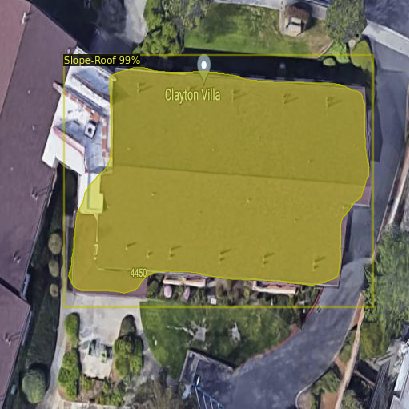

Segmented Area : 149.8189507372148 m


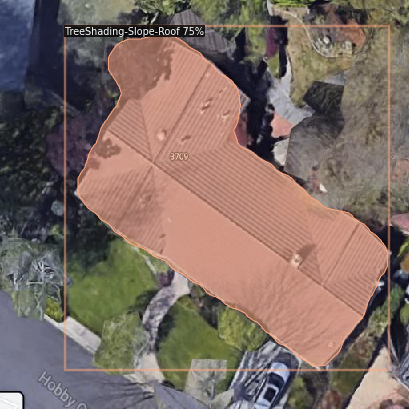

Segmented Area : 145.29613897141246 m


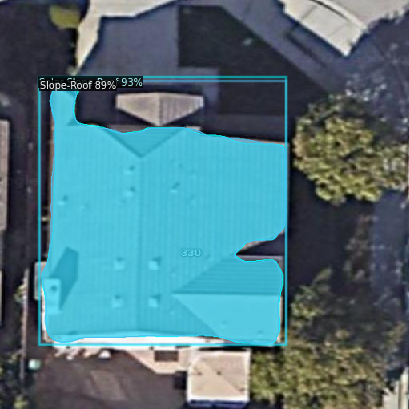

Segmented Area : 166.7987110261947 m


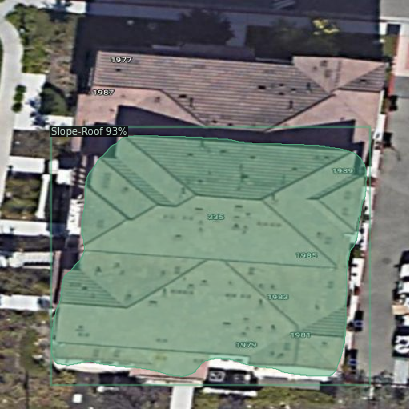

Segmented Area : 175.88910142473298 m


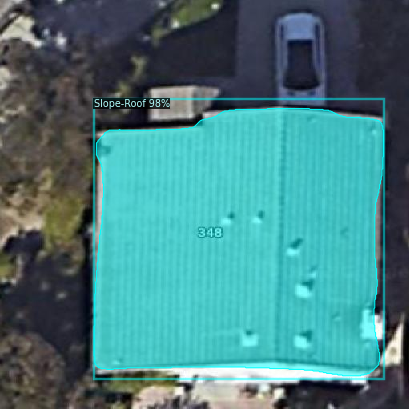

Segmented Area : 147.67004774157826 m


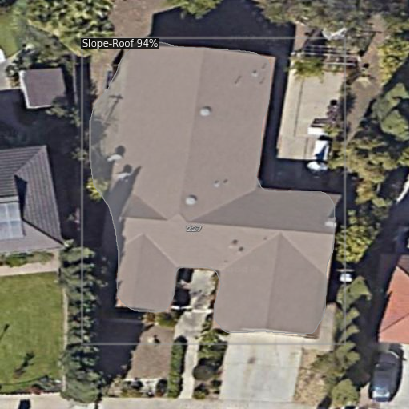

No Segmentation/Classification


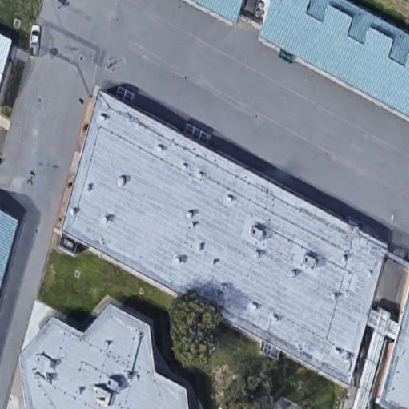

Segmented Area : 199.1377513180261 m


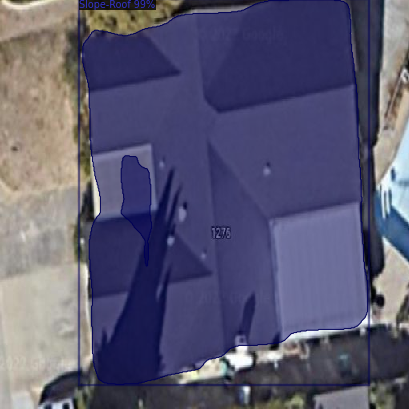

Segmented Area : 140.42397943371353 m


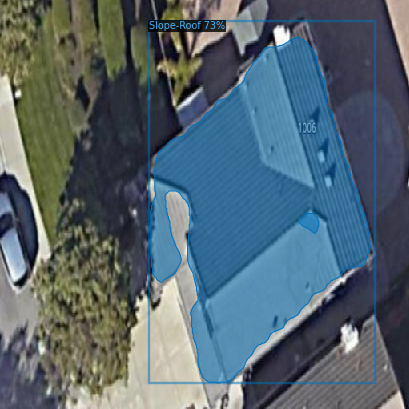

Segmented Area : 120.21108933871285 m


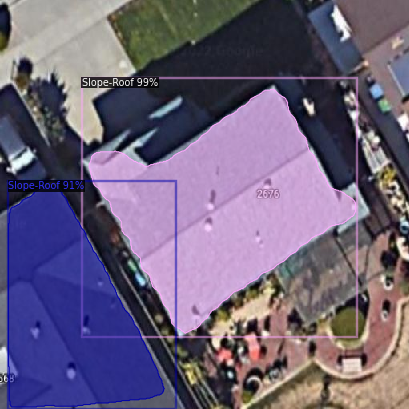

Segmented Area : 110.43151271263109 m


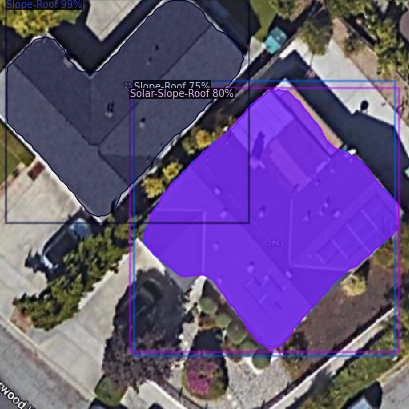

Segmented Area : 141.6711191457172 m


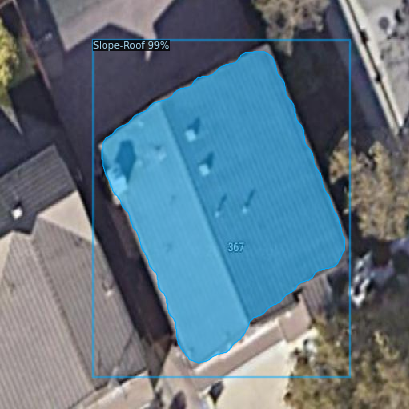

Segmented Area : 133.30475985500294 m


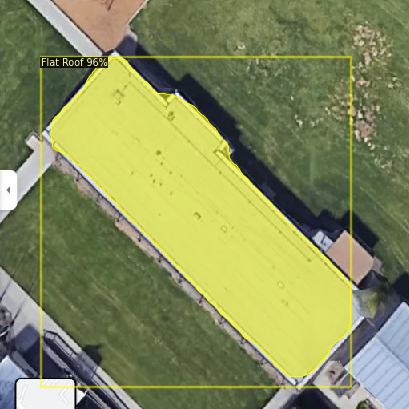

Segmented Area : 149.87989524949637 m


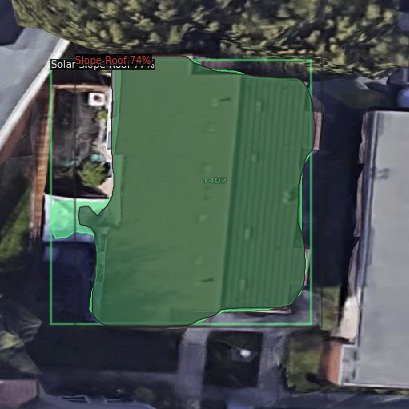

Segmented Area : 160.20867954015478 m


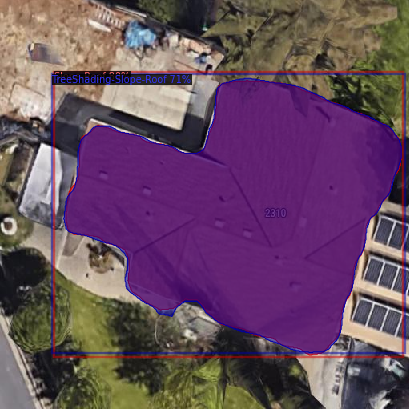

Segmented Area : 176.3406419405351 m


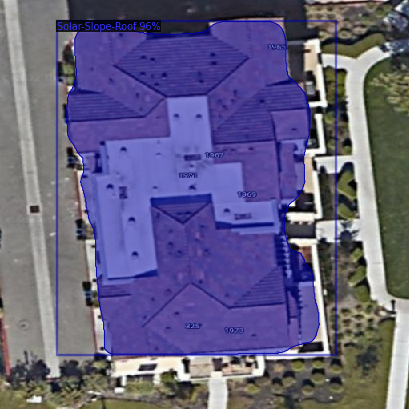

Segmented Area : 160.92183195576666 m


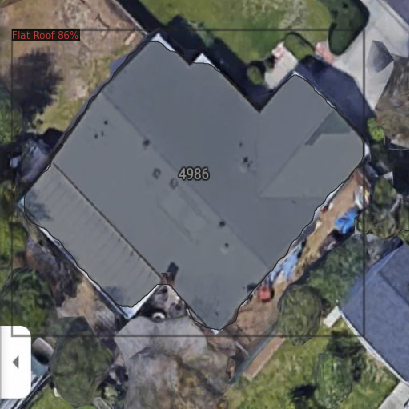

Segmented Area : 135.24055974447904 m


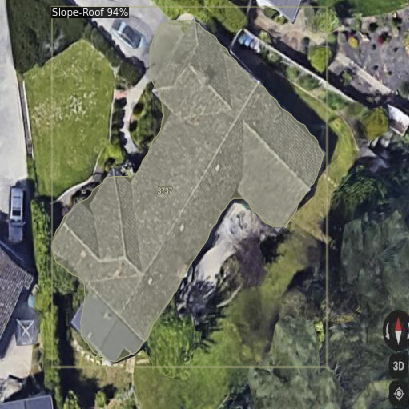

Segmented Area : 131.51575190827904 m


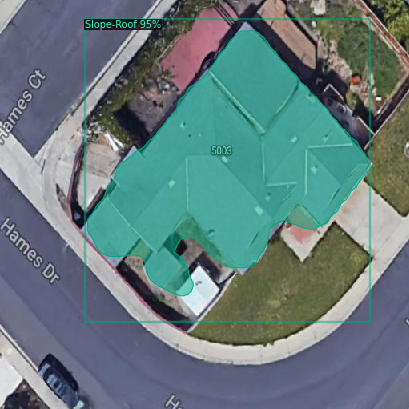

Segmented Area : 205.63834272819844 m


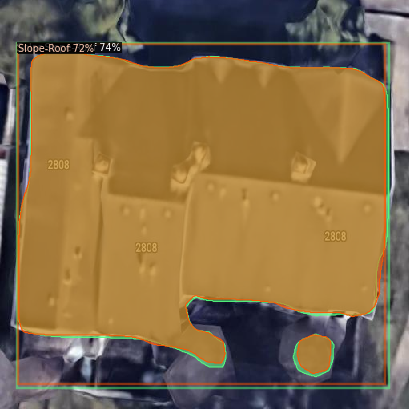

Segmented Area : 182.7964797254039 m


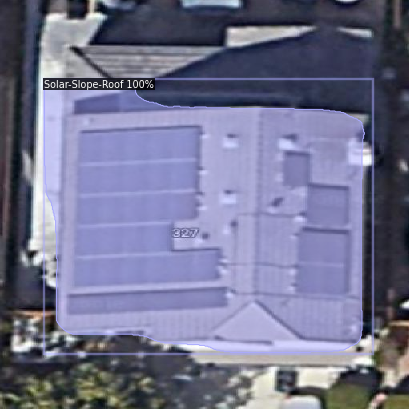

Segmented Area : 205.71280222679385 m


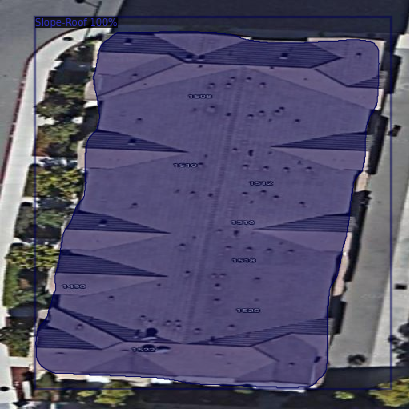

Segmented Area : 165.84499088003835 m


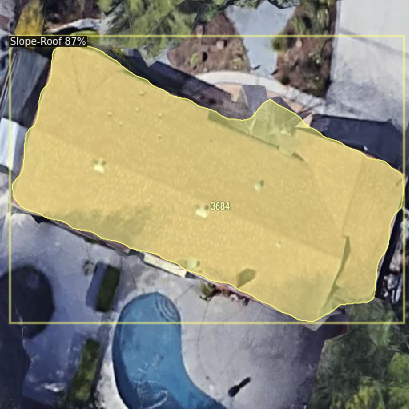

Segmented Area : 112.78434288499446 m


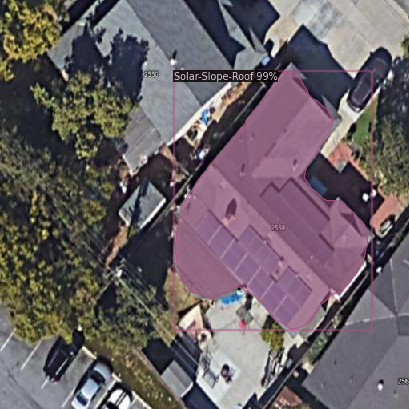

In [32]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob(f'/content/Building Image/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  pixel_area = outputs["instances"].to("cpu").pred_masks.size()[0]
 
  if pixel_area == 0 :
    print('No Segmentation/Classification')
  else:
    print(f'Segmented Area : {(np.sqrt(outputs["instances"].to("cpu").pred_masks[0].numpy().sum()* .281))} m')
  
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])
 

# Download trained model for future inference

In [56]:
!curl https://api.mapbox.com/styles/v1/mapbox/satellite-v9/static/-121.8491,37.3767,19,0/256x256?access_token=pk.eyJ1Ijoic252c3NhaWt1bWFyIiwiYSI6ImNsNnBpMzVhdjA0NXUzY21uMGVzcjY2OXoifQ.vrpbgJTSoha1uPI1RlN_KA --output mapbox_img_1.png

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 22123  100 22123    0     0   392k      0 --:--:-- --:--:-- --:--:--  392k


In [57]:
!curl https://api.mapbox.com/styles/v1/mapbox/satellite-v9/static/-121.8327,37.3704,19,0/256x256?access_token=pk.eyJ1Ijoic252c3NhaWt1bWFyIiwiYSI6ImNsNnBpMzVhdjA0NXUzY21uMGVzcjY2OXoifQ.vrpbgJTSoha1uPI1RlN_KA --output mapbox_img_2.png

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 21536  100 21536    0     0   539k      0 --:--:-- --:--:-- --:--:--  539k


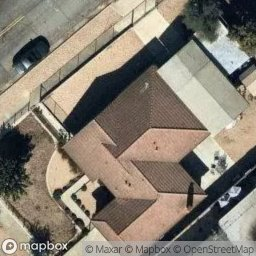

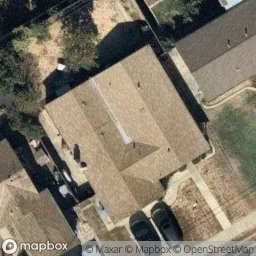

In [58]:
import glob
import cv2
from google.colab.patches import cv2_imshow
# import cv2_imshow
for imageName in glob.glob(f'/content/mapbox_img_*.png'):
  image = cv2.imread(imageName)
  cv2_imshow(image)


In [36]:
f = open('config.yaml', 'w')
f.write(cfg.dump())
f.close()

In [37]:
cfg_read = get_cfg()
cfg_read.merge_from_file('config.yaml')


In [40]:
#!cp /content/output/model_final.pth /content/drive/Shareddrives/DATA298/MaskRCNN_SavedModels/Nov16_2022_4000Iters/

In [41]:
#!cp /content/config.yaml /content/drive/Shareddrives/DATA298/MaskRCNN_SavedModels/Nov16_2022_4000Iters/

[11/17 19:34:17 d2.checkpoint.c2_model_loading]: Following weights matched with model:
| Names in Model                                  | Names in Checkpoint                                                                                  | Shapes                                          |
|:------------------------------------------------|:-----------------------------------------------------------------------------------------------------|:------------------------------------------------|
| backbone.bottom_up.res2.0.conv1.*               | backbone.bottom_up.res2.0.conv1.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (256,) (256,) (256,) (256,) (256,64,1,1)        |
| backbone.bottom_up.res2.0.conv2.*               | backbone.bottom_up.res2.0.conv2.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (256,) (256,) (256,) (256,) (256,8,3,3)         |
| backbone.bottom_up.res2.0.conv3.*               | backbone.bottom_up.res2.0.conv3.{norm.bia

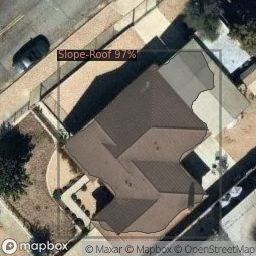

Segmented Area : 68.96 m


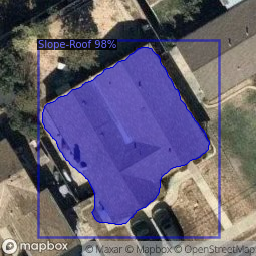

In [60]:
from detectron2.utils.visualizer import ColorMode
import glob

saved_predictor = DefaultPredictor(cfg_read)
for imageName in glob.glob(f'/content/mapbox_img_*.png'):
  image = cv2.imread(imageName)
   
  outputs = saved_predictor(image)


  v = Visualizer(image[:, :, ::-1],
                metadata=test_metadata
                 )
  pixel_area = outputs["instances"].to("cpu").pred_masks.size()[0]
  if pixel_area == 0 :
    print('No Segmentation/Classification')
  else:
    print(f'Segmented Area : {(np.sqrt(outputs["instances"].to("cpu").pred_masks[0].numpy().sum()*.281)):.2f} m')
  
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

# References:-


*   https://roboflow.com
*   https://github.com/facebookresearch/detectron2/blob/main/MODEL_ZOO.md



